# Deepchecks for CV Demo

This notebook demonstrates some checks that were designed to validate a CV model using the deepchecks package.

The use-case showed in this notebook is the face mask detection challenge (https://www.kaggle.com/andrewmvd/face-mask-detection).

In [1]:
%load_ext autoreload
%autoreload 2

### Importing Required Libraries

In [26]:
from bs4 import BeautifulSoup
import torchvision
from torchvision import transforms
import torch
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
import cv2
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import os
import pandas as pd


In [3]:
dataset_path = "./face-mask-detection"
batch_size = 64
num_classes = 3

In [4]:
print(f"torch.cuda.is_available(): {torch.cuda.is_available()}")

torch.cuda.is_available(): False


In [5]:
from masks_utils import generate_box, generate_label, generate_target

## Defining the Torch Dataset

Our dataset is the face mask detection, that can be found here: https://www.kaggle.com/andrewmvd/face-mask-detection

It contains 853 images belonging to 3 classes:
- 1 (with_mask) - if the mask is being weared correctly
- 2 (mask_weared_incorrect) - if a mask is being weared in an incorrect manner
- 0 (without_mask) - if no mask is weared.


In [6]:
class MaskDataset(torch.utils.data.Dataset):
    def __init__(self, dataset_path, transforms):
        self.transforms = transforms
        # load all image files, sorting them to
        # ensure that they are aligned
        self.imgs_dir_path = os.path.join(dataset_path, "images")
        self.annotation_dir_path = os.path.join(dataset_path, "annotations")
        self.num_imgs = len(os.listdir(self.imgs_dir_path))

    def __getitem__(self, idx):
        # === trick to make dataset iterable
        if idx >= len(self):
            raise IndexError

        # load images ad masks
        file_image = "maksssksksss" + str(idx) + ".png"
        file_label = "maksssksksss" + str(idx) + ".xml"
        img_path = os.path.join(self.imgs_dir_path, file_image)
        label_path = os.path.join(self.annotation_dir_path, file_label)
        img = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)
        # Generate Label
        target = generate_target(idx, label_path)

        if self.transforms is not None:
            img = self.transforms(img)

        return img, target

    def __len__(self):
        return self.num_imgs

There is no transformation on the dataset, except for converting it to torch tensors 

In [7]:
data_transform = transforms.Compose(
    [
        transforms.ToTensor(),
    ]
)


dataset = MaskDataset(dataset_path, data_transform)

##  Defining the Train/Test Data

We are splitting the data into 90% training set and 10% test set randomally.

In [8]:
train_num = int(len(dataset) / 10 * 9)
train_dataset, test_dataset = torch.utils.data.random_split(
    dataset, [train_num, len(dataset) - train_num], generator=torch.Generator().manual_seed(42)
)

#### Defining the Dataloaders

From the datasets, here we define the data loaders that will be responsible to iterate over the datasets

In [9]:
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, collate_fn=(lambda batch: tuple(zip(*batch))))
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, collate_fn=(lambda batch: tuple(zip(*batch))))

## Dataset Exploration

Let's view some random image from the training set

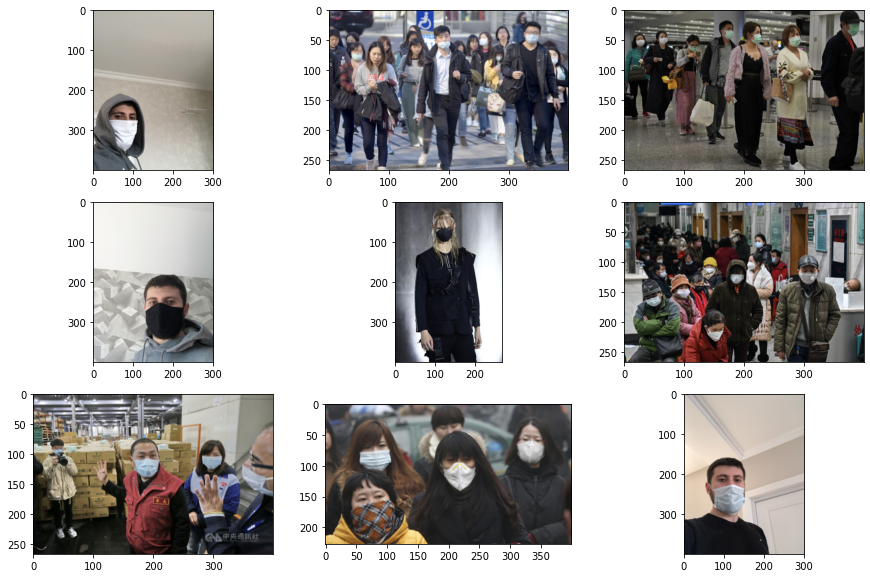

In [10]:
import numpy as np
import matplotlib.pyplot as plt
images = next(iter(train_loader))[0]
f, axarr = plt.subplots(3,3, figsize=(15,10))


for i in [0,1,2]:
    axarr[i,0].imshow(images[i*3].permute(1,2,0))
    axarr[i,1].imshow(images[i*3+1].permute(1,2,0))
    axarr[i,2].imshow(images[i*3+2].permute(1,2,0))


In [11]:
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")


## Loading a Pre-trained Model

Prior to this demo, we've trained a Faster R-CNN model with a ResNet-50-FPN backbone (https://arxiv.org/abs/1506.01497), on this dataset.

Now, we are simply loading the pre-trained weights.

In [12]:
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
in_features = model.roi_heads.box_predictor.cls_score.in_features
# replace the pre-trained head with a new one
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
model.to(device)

params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005, momentum=0.9, weight_decay=0.0005)
    
load_model_path = './model_epoch_17_loss_64.08599090576172.ckpt'
checkpoint = torch.load(load_model_path, map_location=device)

model.load_state_dict(checkpoint["model_state_dict"])
optimizer.load_state_dict(checkpoint["optimizer_state_dict"])
start_epoch_ind = checkpoint["epoch_ind"]

In [13]:
_ = model.eval()

###  Let’s Do a Sample Prediction

  0%|                                                                                                                                                                                                                                                                                             | 0/2 [00:00<?, ?it/s]/Users/itaygabbay/.virtualenvs/mlchecks/lib/python3.9/site-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


Prediction


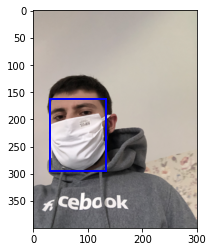

 50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                          | 1/2 [14:48<14:48, 888.56s/it]

Prediction


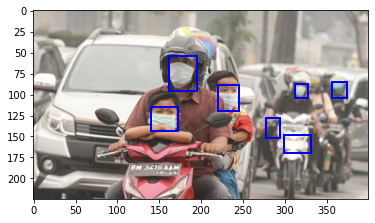

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [18:53<00:00, 566.90s/it]


In [15]:
from tqdm import tqdm
from masks_utils import plot_image
for imgs, annotations in tqdm(test_loader):
    imgs = list(img.to(device) for img in imgs)
    preds = model(imgs)

    print("Prediction")
    plot_image(imgs[0], preds[0])

# Using Deepchecks to Validate the Model

Now we got to the interesting part - how to validate the model using deepchecks.vision module. We are going to demonstrate 5 checks:

- Dataset Dimensions Check
- Train/Test Label Drift Check
- Performance Checks
  - Mean Average Precision
  - Mean Average Recall
- Robustness Checks
  - Robustness
  - Suspicious Robustness

## 1. Implementing Formatting Functions for the Labels and Predictions

Formatting the label and predictions to a format deepchecks can work with.

In the context of object detection tasks, for the label formatting, deepchecks support labels in the following format:
$[ClassID, x, y, w ,h]$, where x, y, w, h represent the upper left corner of the bounding box and its width and height. 

In addition, deepchecks provides utilities functions to convert from well known formats of bboxes, such as **xyxy, cxcywh, xywhn, YOLO format**, and more..


For the predictions formatting, deepchecks expects the detection in the following format:
$[x, y, w, h, confidence, ClassID]$, where x and y are the coordinates (in pixels) of the upper left corner of the
bounding box, w and h are the width and height of the bounding box (in pixels), confidence is the confidence of the model and class_id is the class id.

In [14]:
def label_formatter_func(annotation_dict_tuple):
    return_list = []
    if isinstance(annotation_dict_tuple, dict):
        annotation_dict_tuple = [annotation_dict_tuple]
    for annotation_dict in annotation_dict_tuple:
        x1y1x2y2_tensor = annotation_dict["boxes"]
        xy_tensor = x1y1x2y2_tensor[:, :2]
        wh_tensor = x1y1x2y2_tensor[:, 2:4] - x1y1x2y2_tensor[:, :2]

        label_tensor = annotation_dict["labels"].reshape(-1, 1)

        xywh_label_tensor = torch.hstack([label_tensor, xy_tensor, wh_tensor])

        return_list.append(xywh_label_tensor)
    
    return return_list 


def prediction_formatter_func(annotation_dict_list):
    list_corrected_predictions = []
    for annotation_dict in annotation_dict_list:

        x1y1x2y2_tensor = annotation_dict["boxes"]
        xy_tensor = x1y1x2y2_tensor[:, :2]
        wh_tensor = x1y1x2y2_tensor[:, 2:4] - x1y1x2y2_tensor[:, :2]

        label_tensor = annotation_dict["labels"].reshape(-1, 1)

        confidence_tensor = annotation_dict["scores"].reshape(-1, 1)

        xywh_label_conf_tensor = torch.hstack([xy_tensor, wh_tensor, confidence_tensor, label_tensor])
        
        list_corrected_predictions.append(xywh_label_conf_tensor)

    return list_corrected_predictions

## 2. Creating the Datasets

In [15]:
from deepchecks.vision import VisionData
from deepchecks.vision.utils.detection_formatters import DetectionLabelFormatter, DetectionPredictionFormatter
label_formatter = DetectionLabelFormatter(label_formatter_func)
prediction_formatter = DetectionPredictionFormatter(prediction_formatter_func)

ds_train = VisionData(train_loader, label_formatter=label_formatter)
ds_test = VisionData(test_loader, label_formatter=label_formatter)

## 3. Dataset Dimensions Check

Let's explore our dataset. What are the distributions of the image dimensions? And the number of bounding boxes per image? This may help us to detect outliers in the labeling mechanism or to understand weird behavior of the model

In [25]:
from dimensions_check import ImageDimensionsCheck

ImageDimensionsCheck().run(ds_train)

libpng warning: iCCP: Not recognizing known sRGB profile that has been edited


Image Dimensions Check Additional Outputs

## 4.  Testing Correct Separation to Train/Test Sets Using the TrainTestLabelDrift Check

Sometimes the splits to train/test sets cause unequal distributions of the target variable. This may harm the model performance on the test set. 

Let's check the distribution of the target variable in the context of an object detection task.

In [17]:
from deepchecks.vision.checks.distribution import TrainTestLabelDrift

TrainTestLabelDrift().run(ds_train, ds_test)

libpng warning: iCCP: Not recognizing known sRGB profile that has been edited
libpng warning: iCCP: Not recognizing known sRGB profile that has been edited


Train Test Label Drift Calculate label drift between train dataset and test dataset, using statistical measures. Read More... Additional Outputs 
 The Drift score is a measure for the difference between two distributions, in this check - the test
 and train distributions of different measurement(s) on the label.

## 5. Evaluation Checks 

#### We can see the model detects faces correctly. However we need a deeper investigation.


How does the model perform on different bbox sizes, on different evaluation metrics?

In [18]:
from performance_report import MeanAveragePrecisionReport, MeanAverageRecallReport

In [34]:
MeanAveragePrecisionReport(prediction_formatter).run(ds_test, model)

,Area size,mAP(COCO challenge) (%),AP@.50 (%),AP@.75 (%)
0,All,34.90,55.70,37.40
1,Small (area<32^2),15.60,30.40,17.90
2,Medium (32^2<area<96^2),38.70,60.10,42.70
3,Large (area<96^2),50.90,92.60,53.40


In [20]:
MeanAverageRecallReport(prediction_formatter).run(ds_test, model)

,Area size,AR@100 (%),AR@1 (%),AR@10 (%)
0,All,45.90,11.20,26.40
1,Small (area<32^2),25.00,5.40,12.60
2,Medium (32^2<area<96^2),49.30,12.40,23.20
3,Large (area<96^2),62.00,20.40,31.20


## 6. Evaluating the Robustness of Our Model 

After evaluating the model performance, it's important to understand its robustness to unique examples

In [21]:
from robustness_check import RobustnessReport

Robustness Report Check several image enhancements for model robustness. Additional Outputs Performance Comparison

Examples


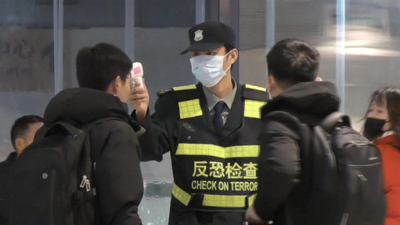
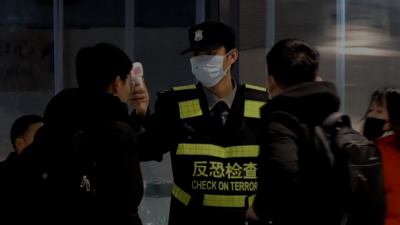
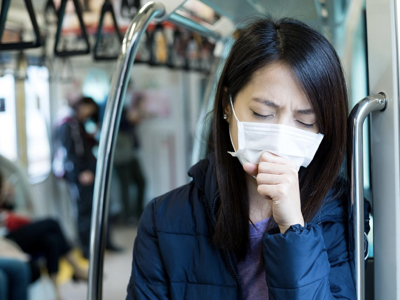
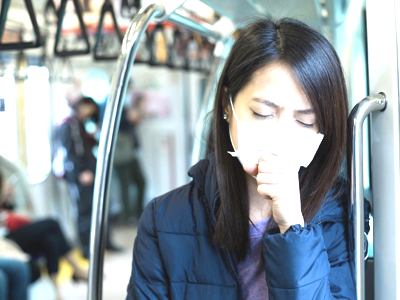
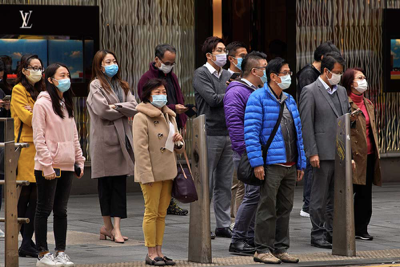
...
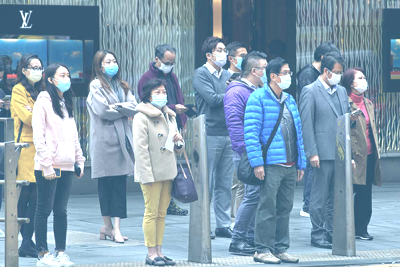
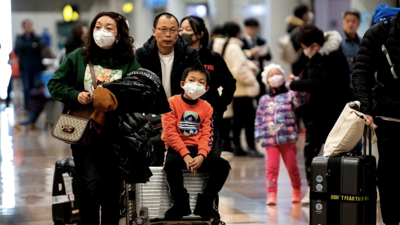
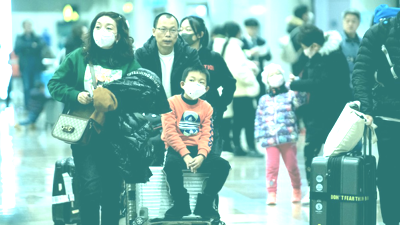
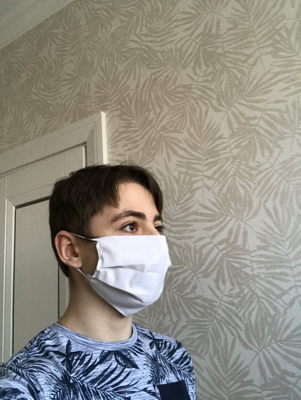
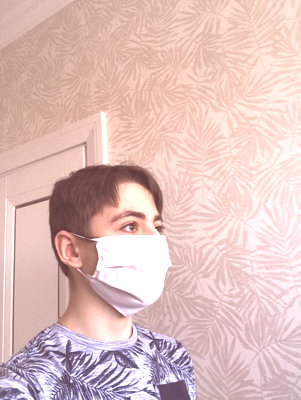

In [22]:
check = RobustnessReport(prediction_extract=prediction_formatter)
check.run(ds_test, model)

## 7. The Suspicious Robustness Check

Sometimes, our model is too robust. That means it may be overfitted on certain augmentations or learned features that are not related to the problem. This check helps us detect that.

In [23]:
from suspicious_robustness import SuspiciousRobustness


Suspicious Robustness This check is designed to detect if the dataset is suspiciously robust. Additional Outputs


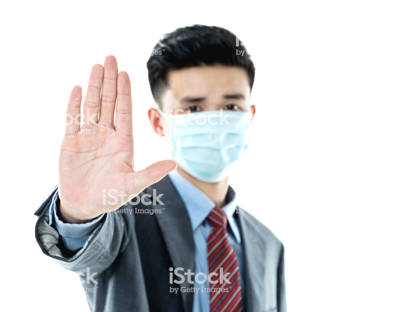
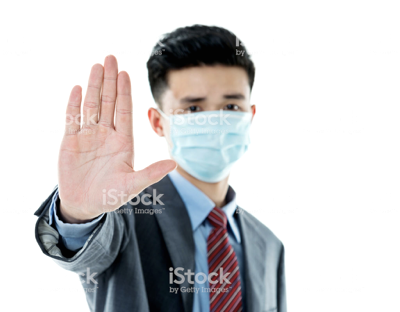
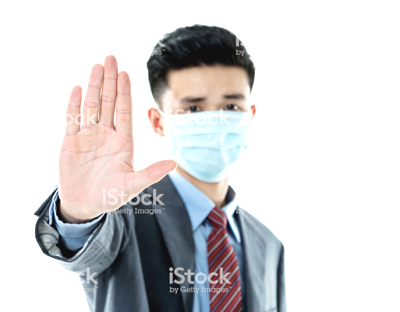
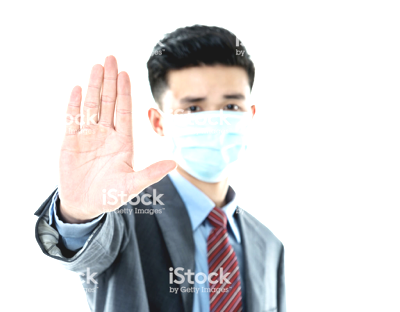
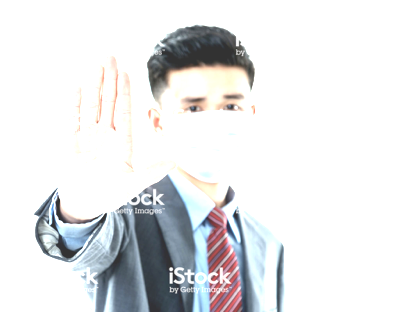
...
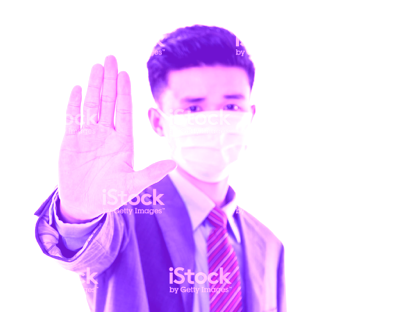
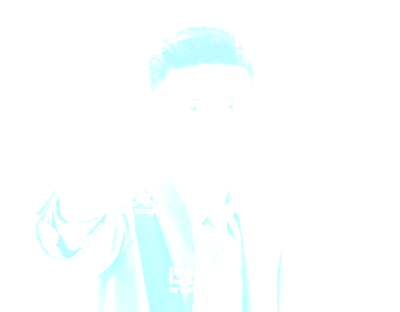
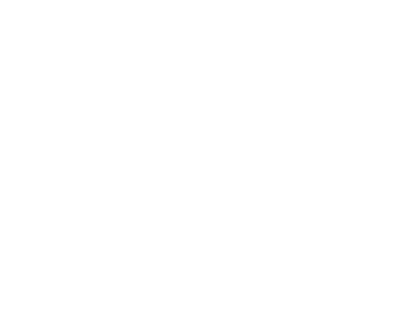
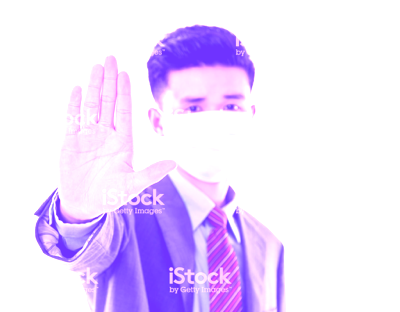
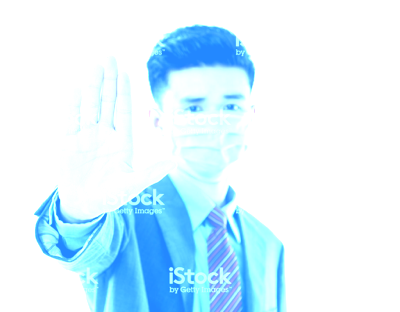

In [24]:
check = SuspiciousRobustness(prediction_formatter)
check.run(ds_test, model)

#### And now - back to the formattings